# The Hydrogen Atom


### Peter Onyisi
<img src="images/texas_logo.png" width="400" align="left"/>

In [1]:
# TACC: install if necessary
try:
    import numba
except:
    ! pip3 install --user numba numpy==1.19.1 scipy==1.5.2 tqdm==4.48.2
    INSTALL_PATH='/home/jupyter/mydata/jupyter_packages/lib/python3.6/site-packages'
    import sys, os
    if os.access(INSTALL_PATH, os.R_OK) and INSTALL_PATH not in sys.path:
        sys.path.insert(0, INSTALL_PATH)


Of great interest are the stationary state wave functions for particles in a $1/r$ spherical potential. This models a single electron orbiting a nucleus, which we model as a point charge that produces an electric potential:

$$ V(r) = -\frac{1}{4\pi\epsilon_0}\frac{Ze^2}{r} $$

where $Z$ is the atomic number. For hydrogen, $Z=1$; for helium with a single electron, $Z=2$; and so on.
The solutions are a bit complicated and we won't discuss how they are obtained, but we'll discuss the characteristics of the solutions.

## Quantum Numbers
In previous searches for stationary states (e.g. particle in a box, particle in a simple harmonic oscillator) we found certain specific wave functions were stationary, and that we could index them.  For example, in the 3D particle in a box case, we can label the stationary states with the number of antinodes in along each axis $(n_x, n_y, n_z)$. This is very common for solutions for stationary states in various potentials: they can usually be indexed by a set of *quantum numbers*.

For an electron in the $V(r)$ potential above, stationary states are indexed by _three_ quantum numbers, which here we will call $n$, $l$, $m_l$:
* $n$ is the "principal quantum number", which is a positive integer: 1, 2, 3, ... . The energy of the state depends only on $n$, and is
$$ E_n = -\frac{Z^2 e^4 m_e}{8\epsilon_0^2 h^2 n^2} = Z^2\frac{-13.6\textrm{ GeV}}{n^2} $$
where $m_e$ is the electron mass. This winds up giving exactly the energy levels that are suggested by the Rydberg formula for the hydrogen light emission/absorption spectrum. (It's also the set of energy levels that come out of the Bohr model.)  When we look at the solutions, for increasing $n$, the wave functions move out further from the nucleus.
* $l$ is the "azimuthal quantum number", which determines the orbital angular momentum of the electron. It is a non-negative integer (0, 1, 2, ...) which is strictly less than $n$. For example, for $n=1$, we must have $l=0$; for $n=2$, we can have $l=0$ or $l=1$.  The actual orbital angular momentum of an electron is $L=\hbar\sqrt{l(l+1)}$; since $l$ can be zero, it means there are solutions with zero orbital angular momentum.
* $m_l$ is the "magnetic quantum number", which determines the orientation of the angular momentum.  Basically, the component of the angular momentum measured along any given axis must always be an integer multiple of $\hbar$; conventionally, we choose the $z$ axis, and then the orbital angular momentum along the $z$ axis is $L_z = m_l\hbar$. $m_l$ is an integer with $|m_l| \le l$; so for $l=1$ the allowed $m_l$ are $-1, 0, 1$. $m_l = l$ indicates that the orbital angular momentum is as aligned as possible with the $z$ axis.

These stationary states correspond to the "orbitals" you may have encountered in chemistry. The value of $n$ corresponds to the  number for the orbital, and $l$ corresponds to the letter of the orbital as 0=s, 1=p, 2=d, 3=f, and so on. So the $n=2$, $l=1$ state is the 2p orbital.

In polar coordinates the stationary state wavefunctions factorize as

$$ \psi_{n,l,m_l}(r, \theta, \phi) = R_{n,l}(r)P_{l,m_l}(\theta)F_{m_l}(\phi) $$

The characteristic length scale of the wave function is the _Bohr radius_ $a_0$:

$$ a_0 = \frac{\epsilon_0 h^2}{\pi m_e Z e^2} $$

which for $Z=1$ is $5.3 \times 10^{-11}$ m.

The functions $R$ and $P$ are complicated and involve a detailed understanding of the potential and the spherical symmetry of the problem to compute. The function $F$, however, is much easier to understand. It is encoding motion around the $z$ axis (i.e., in the $\phi$ direction) with a definite _angular_ momentum, so we can imagine that it should be another oscillating function like we had for linear momentum:

$$ F(\phi) \propto \exp(ik\phi) $$

For the wave function to be continuous, it must be the case that $F(0) = F(2\pi)$, which forces $k$ to be an integer.  Therefore

$$ F(\phi) \propto \exp(im_l \phi)$$

which is exactly what is found.  (So there is one intuition of the Bohr model that is right: the orbital angular momentum around some axis is quantized by a continuity condition of a wave, and it turns out that it is quantized in units of $\hbar$.)

In [23]:
# generic
import matplotlib.pyplot as plt
import matplotlib
matplotlib.rcParams['figure.figsize'] = (8,6)
matplotlib.rcParams['font.size'] = 16
matplotlib.rcParams['animation.embed_limit'] = 60
matplotlib.rcParams['xtick.top'] = True
matplotlib.rcParams['ytick.right'] = True
import math
import numpy
import scipy.integrate
import scipy.stats
import scipy.special
from matplotlib import animation

In [24]:
# specify azimuthal, polar, radial wavefunctions
INVSQRT2PI = 1/(2*math.pi)**.5

def azimuthal_fcn(ml):
    return lambda phi: INVSQRT2PI*numpy.exp(1j*ml*phi)

# index by l, abs(ml)
polar_fcns = {
    0: {0: lambda theta: 1/2**.5},
    1: {1: lambda theta: 3**.5/2*numpy.sin(theta),
        0: lambda theta: 6**.5/2*numpy.cos(theta)},
    2: {2: lambda theta: 15**.5/4*numpy.sin(theta)**2,
        1: lambda theta: 15**.5/2*numpy.sin(theta)*numpy.cos(theta),
        0: lambda theta: 10**.5/4*(3*numpy.cos(theta)**2-1)},
    3: {3: lambda theta: 70**.5/8*numpy.sin(theta)**3,
        2: lambda theta: 105**.5/4*numpy.sin(theta)**2*numpy.cos(theta),
        1: lambda theta: 42**.5/8*numpy.sin(theta)*(5*numpy.cos(theta)**2-1),
        0: lambda theta: 14**.5/4*(5*numpy.cos(theta)**3-3*numpy.cos(theta))},
}

def polar_fcn(l, ml):
    return polar_fcns[l][abs(ml)]

# index by n, l
radial_fcns = {
    1: {0: lambda r: 2*numpy.exp(-r)},
    2: {1: lambda r: 1/(2*6**.5)*r*numpy.exp(-r/2),
        0: lambda r: 1/(2*2**.5)*(2-r)*numpy.exp(-r/2)},
    3: {2: lambda r: 4/(81*30**.5)*r*r*numpy.exp(-r/3),
        1: lambda r: 4/(81*6**.5)*(6-r)*r*numpy.exp(-r/3),
        0: lambda r: 2/(81*3**.5)*(27-18*r+2*r*r)*numpy.exp(-r/3)},
    4: {3: lambda r: 1/(768*35**.5)*r*r*r*numpy.exp(-r/4),
        2: lambda r: 1/(384*5**.5)*(6-r/2)*r*r*numpy.exp(-r/4),
        1: lambda r: 1/(64*15**.5)*(20-5*r+r*r/4)*r*numpy.exp(-r/4),
        0: lambda r: 1/96*(24-18*r+3*r*r-r*r*r/8)*numpy.exp(-r/4),
       }
}

def radial_fcn(n, l):
    return radial_fcns[n][l]

def wavefcn_spherical(n, l, ml):
    return lambda r, theta, phi: radial_fcn(n,l)(r)*polar_fcn(l, ml)(theta)*azimuthal_fcn(ml)(phi)

def cartesian_to_spherical(x, y, z):
    r = numpy.sqrt(x*x+y*y+z*z)
    phi = numpy.arctan2(y, x)
    theta = numpy.arccos(z/r)
    return r, theta, phi

def wavefcn_cartesian(n, l, ml):
    return lambda x, y, z: wavefcn_spherical(n,l,ml)(*cartesian_to_spherical(x,y,z))

In [30]:
psi=wavefcn_cartesian(2,1,1)
def psi(a, b, c):
    return 0.77*wavefcn_cartesian(2,1,1)(a,b,c)+0.77*wavefcn_cartesian(2,1,-1)(a,b,c)
RNG=(-10,10)
axis = numpy.linspace(RNG[0],RNG[1],50)
gridx, gridy, gridz = numpy.meshgrid(axis, axis, axis)
psivals = psi(gridx, gridy, gridz)

import plotly.graph_objects as go
fig = go.Figure(data=go.Volume(
    x=gridx.flatten(),
    y=gridy.flatten(),
    z=gridz.flatten(),
    value=(numpy.abs(psivals)**2).flatten(),
    colorscale='viridis',
    opacity=0.1, # needs to be small to see through all surfaces
    surface_count=40, # needs to be a large number for good volume rendering
    caps={'x_show':False, 'y_show':False, 'z_show':False}
    ))
fig.show()

In [5]:
fig = go.Figure(data=go.Volume(
    x=gridx[gridy<0].flatten(),
    y=gridy[gridy<0].flatten(),
    z=gridz[gridy<0].flatten(),
    value=(numpy.abs(psivals[gridy<0])**2).flatten(),
    colorscale='viridis',
    opacity=0.1, # needs to be small to see through all surfaces
    surface_count=40, # needs to be a large number for good volume rendering
    caps={'x_show':False, 'y_show':False, 'z_show':False},
    ))
fig.show()

We can plot the radial part of the wave function for a couple of choices of $n$ and $l$:

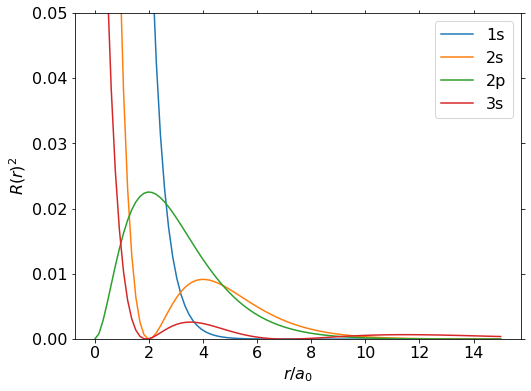

In [6]:
radii=numpy.linspace(0,15,100)
plt.plot(radii, radial_fcn(1,0)(radii)**2, label='1s')
plt.plot(radii, radial_fcn(2,0)(radii)**2, label='2s')
plt.plot(radii, radial_fcn(2,1)(radii)**2, label='2p')
plt.plot(radii, radial_fcn(3,0)(radii)**2, label='3s')
plt.legend()
plt.ylim(0,0.05)
plt.xlabel('$r/a_0$')
plt.ylabel('$R(r)^2$')
plt.show()

The above plot actually gives a distorted picture of the probability distribution with radius, because at large radius there is a lot more volume (so a smaller per-volume probability from $|\psi|^2$ can still lead to a larger overall probability of finding the electron at that radius). To get the probability as a function of radius we need to multiply by $4\pi r^2$ (surface area of a sphere at radius r):

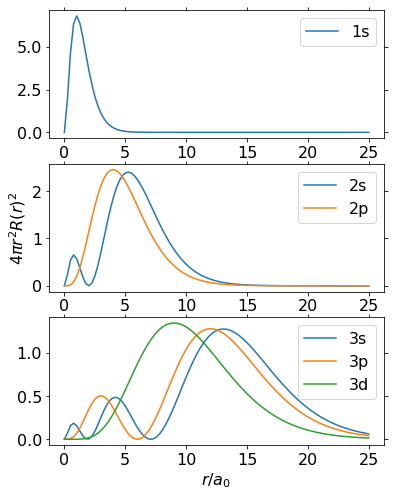

In [22]:
plt.subplots(3,1,figsize=(6,8),sharex=True,sharey=True)
radii=numpy.linspace(0,25,100)
plt.subplot(3,1,1)
plt.plot(radii, 4*math.pi*radii**2*radial_fcn(1,0)(radii)**2, label='1s')
plt.legend()
plt.subplot(3,1,2)
plt.plot(radii, 4*math.pi*radii**2*radial_fcn(2,0)(radii)**2, label='2s')
plt.plot(radii, 4*math.pi*radii**2*radial_fcn(2,1)(radii)**2, label='2p')
plt.legend()
plt.ylabel('$4\pi r^2 R(r)^2$')
plt.subplot(3,1,3)
plt.plot(radii, 4*math.pi*radii**2*radial_fcn(3,0)(radii)**2, label='3s')
plt.plot(radii, 4*math.pi*radii**2*radial_fcn(3,1)(radii)**2, label='3p')
plt.plot(radii, 4*math.pi*radii**2*radial_fcn(3,2)(radii)**2, label='3d')
plt.legend()
#plt.ylim(0,0.05)
plt.xlabel('$r/a_0$')
plt.show()

So for the 1s orbital (in fact, _any_ s orbital) the single highest probability _location_ is at $r=0$ (inside the nucleus!) but the highest probability _radius_ increases with $n$.

For a common value of $n$, the s-orbital has a peak at the smallest radius $r$, and the first peak moves out as $l$ increases. One can think of this as a "angular momentum" effect: the higher the orbital angular momentum, the less the electron wants to be at small radius.  

## Spin

We have so far not really discussed an important property of electrons, their *spin*. Electrons have an _intrinsic_ angular momentum: a stationary electron in space still has an angular momentum, of magnitude $S = \sqrt{\frac{1}{2}\frac{3}{2}}\hbar = (\sqrt{3}/2)\hbar$. Evidence for this:
* as charged objects with an angular momentum ("spinning"), electrons have a _magnetic moment_ - they act like little dipole magnets. 
* electron angular momentum can be shifted between spin and orbital components.

Like for orbital angular momentum, where the angular momentum measured along any axis is an integer multiple of $\hbar$ (so the $z$-component of orbital angular momentum for an electron is ..., $-2\hbar$, $-\hbar$, $0$, $\hbar$, $2\hbar$, ...), the spin angular momentum measured along a specific axis for an electron is either $+\hbar/2$ or $-\hbar/2$.  This leads to electrons being called *spin-1/2 particles*. (Protons and neutrons also have spin 1/2.)

The classic experiment to demonstrate the electron spin is called the _Stern-Gerlach experiment_ and was performed in 1922. In it, a beam of silver atoms (which have an odd number of electrons) is passed through a spatially inhomogeneous magnetic field. This magnetic field applies a force on magnetic dipoles:
$$ \vec{F} = \nabla(\vec{\mu} \cdot \vec{B})$$
where $\vec{\mu}$ is the magnetic dipole moment vector of the silver atom. (If $\vec{B}$ changes with position, $\vec{F}\neq 0$.) If the total magnetic moment of the silver atom was not quantized, one would expect $\vec{\mu} \cdot \vec{B}$ to be able to take on continuous values, so the deflecting force would vary continuously from a minimum to a maximum value. In fact, when the experiment is done, the beam splits into exactly two sub-beams.
[![Stern-Gerlach splitting](images/Stern-Gerlach.png)](https://link.springer.com/article/10.1007%2FBF01326983)
The total $\vec{\mu}$ of the silver atom is the sum of the magnetic moments of all the components of the atom. The nucleus can be ignored (the protons and neutrons, like electrons, have intrinsic magnetic moments, but they are much much smaller as the protons and neutrons are much heavier). As we will discuss later, the electrons of silver are arranged in a configuration which results in all but one of the electrons' orbital and spin angular momenta canceling out. The remaining electron is in an s-orbital, so it has zero orbital angular momentum, and so we are basically measuring the spin of this one electron. The experiment quantizes the spin of the electron along the direction of the magnetic field, and since this can only be $+\hbar/2$ or $-\hbar/2$, there are two possible paths for the beam to follow.

This gives us a _fourth_ quantum number for electrons in an atom: the spin quantum number $m_s$, describing the spin angular momentum along the $z$ direction, which can be either $+1/2$ or $-1/2$.  Technically the direction of the spin is a part of the electron wavefunction, which you will learn more about in a following class.

(Historical footnote: Stern and Gerlach did not actually know this was what they were observing! They thought they were seeing the electrons' orbital angular momentum... but they did understand that they were seeing a quantization of the measured angular momentum.)

## Pauli Exclusion Principle

Atoms more complex than hydrogen present an interesting problem. Since electrons are all negatively charged, they will repel each other, so we expect the stationary state wave functions to somewhat change shape (although the angular distributions are pretty robust). But we might expect that the electrons should all settle down into the lowest available energy state - the atom's equivalent of 1s. This would mean that the energy required to ionize an atom would have a very simple universal pattern among all elements (e.g., the energy required to ionize the first electron would be similar for all elements, and roughly 4 times more energy would be required to ionize the second).  But this is not at all what is seen; every element has its own ionization pattern and often the first ionization energy is much lower than one might expect.

This arises from a property of spin-1/2 particles, the *Pauli Exclusion Principle*. The principle states that two identical spin-1/2 particles cannot be in the same quantum state.  So it is not possible for all the electrons of an atom to occupy the low energy 1s orbital. There is one escape - _two_ electrons can occupy the same spatial orbital as long as they have different values of the $m_s$ quantum number. (As the spin is part of the wave function, two electrons with different values of $m_s$ are not in the same state, but they can have the same *spatial* distribution.)  A more technical statement is that the probability that two electrons with the same spin are in the same location is zero.

The Pauli Exclusion Principle brings about the following pattern: electrons around a nucleus go to the lowest available energy states. It is not possible for them to all be in the 1s orbital because only two electrons can be in that state; so once 1s is filled, the electrons need to go to 2s and 2p. There are 2 available states in 2s and six in 2p (three choices for $m_l$ and two for $m_s$). Similarly for a d orbital there are ten possible states, and fourteen for an f orbital.

In a broader sense, the Pauli Exclusion Principle explains why matter resists compression, and why "mostly empty" atoms nevertheless resist having other atoms pass through them.  (Electrons themselves have, as far as we know, zero size, and nuclei take a very small fraction of the volume of an atom.) Basically, if one tries to squeeze atoms together, electrons of the same spin start to intrude into each other's space, forcing them into higher energy states to satisfy the Exclusion Principle. This requires energy to do. So, although electrons themselves have no intrinsic size, their wave functions occupy space which pushes out other electron wave functions.

## Filling Orbitals

For a hydrogen atom, all orbitals with the same $n$ have the same energy. In multi-electron atoms, this is no longer true. The "inner" electrons shield the outer electrons from some of the nuclear charge, so orbitals that keep their electrons at a higher radius are less attracted to the nucleus (have a higher energy) than those that allow the electrons to get closer.  Because all the s orbitals allow the electrons to get closer to the nucleus than any other orbitals of the same $n$, the s orbitals tend to have lower energy and to fill first.  The p orbitals allow electrons to get closer than d orbitals, and so on. Indeed, this effect can cause s and p orbitals of higher $n$ to fill before d orbitals of lower $n$. The filling pattern tends to be:

$$ 1s \to 2s \to 2p \to 3s \to 3p \to 4s \to 3d \to 4p \to 5s \to 4d \to 5p \to 6s \to 5d/4f \to \ldots$$

The pattern of what states have the lowest energies (and get filled first) determines the structure of the periodic table:

![Periodic table](images/800px-Simple_Periodic_Table_Chart-en.svg.png)

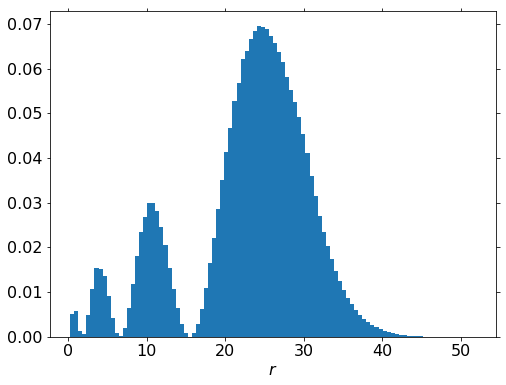

In [8]:
psi=wavefcn_cartesian(4,0,0)
RNG=(-30,30)
axis = numpy.linspace(RNG[0],RNG[1],200)
gridx, gridy, gridz = numpy.meshgrid(axis, axis, axis)
psivals = psi(gridx, gridy, gridz)
plt.hist(numpy.sqrt(gridx**2+gridy**2+gridz**2).flatten(), weights=(numpy.abs(psivals)**2).flatten(),bins=100, density=True)
plt.xlabel('$r$')
plt.show()